In [9]:
# %%
# --- IMPORTS ---
import os
import textwrap
from datetime import date, timedelta
from pathlib import Path
import warnings

import pandas as pd
from dotenv import load_dotenv
import snowflake.connector

# Suppress the specific pandas UserWarning for non-SQLAlchemy connections
warnings.filterwarnings(
    'ignore',
    category=UserWarning,
    message='pandas only supports SQLAlchemy connectable.*'
)

# --- CONFIGURATION (UPDATED FOR BEHAVIORAL SESSIONIZATION) ---
# Load .env file from parent directory
load_dotenv('../.env')  # Fix: Load from parent directory where .env actually is

# ANALYSIS_END_DATE: The anchor date for our analysis
ANALYSIS_END_DATE = date(2025, 9, 21)

# DAYS_WINDOW: Increased to capture complete shopping sessions
# We need enough history to see multiple shopping sessions with 7-day gaps
DAYS_WINDOW = 180  # Increased to capture multiple shopping sessions

# SAMPLING_FRACTION: Reduced to manage data volume with longer history
# Fewer users but deeper behavioral data per user
SAMPLING_FRACTION = 0.00025  # Reduced from 0.001

# --- Behavioral Session Parameters ---
# SESSION_GAP_MINUTES: Defines inactivity threshold for a "browsing session"
# If a user is inactive for more than this duration, their next event starts a new browsing session
SESSION_GAP_MINUTES = 30

# SHOPPING_SESSION_GAP_DAYS: Defines inactivity threshold for a "shopping session"
# If a user is inactive for more than this duration, their next event starts a new shopping session
# This uses the SAME LOGIC as browsing sessions - based on inactivity gaps, not fixed windows
SHOPPING_SESSION_GAP_DAYS = 7

# --- Legacy Parameters (kept for backward compatibility) ---
JOURNEY_WINDOW_HOURS = 48  # Still used by the 360° case study function

# --- SNOWFLAKE CONNECTION ---
try:
    conn = snowflake.connector.connect(
        user=os.getenv('SNOWFLAKE_USER'),
        password=os.getenv('SNOWFLAKE_PASSWORD'),
        account=os.getenv('SNOWFLAKE_ACCOUNT'),
        warehouse=os.getenv('SNOWFLAKE_WAREHOUSE', 'COMPUTE_WH'),
        database='INCREMENTALITY',
        schema='INCREMENTALITY_RESEARCH'
    )
    print("[SUCCESS] Snowflake connection established.")
except Exception as e:
    print(f"[FAILURE] Could not connect to Snowflake: {e}")

[SUCCESS] Snowflake connection established.


In [10]:
# %%
# --- DATA FETCHING FUNCTION ---

def get_robust_journey_and_catalog_data(conn, start_date: str, end_date: str, sampling_fraction: float) -> tuple:
    """
    Fetches raw journey data and catalog data from Snowflake with user sampling.
    Uses efficient CTE-based approach with enhanced catalog parsing.
    
    Args:
        conn: Snowflake connection object
        start_date (str): Start date in 'YYYY-MM-DD' format
        end_date (str): End date in 'YYYY-MM-DD' format
        sampling_fraction (float): Fraction of users to sample (e.g., 0.001 for 0.1%)
    
    Returns:
        tuple: (journey_data dict, catalog_data DataFrame)
    """
    print(f"  Fetching data from {start_date} to {end_date}")
    print(f"  Sampling fraction: {sampling_fraction:.4%}")
    
    journey_data = {}
    
    # Build shared CTE for deterministic user sampling
    total_buckets = 10000
    selection_threshold = max(1, int(total_buckets * sampling_fraction))  # Ensure at least 1 bucket
    
    cte_sql = textwrap.dedent(f"""
    WITH SAMPLED_USER_IDS AS (
        SELECT OPAQUE_USER_ID FROM (
            SELECT OPAQUE_USER_ID, MOD(ABS(HASH(OPAQUE_USER_ID)), {total_buckets}) AS bucket
            FROM (SELECT DISTINCT OPAQUE_USER_ID FROM AUCTIONS_USERS 
                  WHERE CREATED_AT BETWEEN '{start_date}' AND '{end_date}')
        ) WHERE bucket < {selection_threshold}
    )
    """)
    
    # 1. AUCTIONS_USERS - using shared CTE
    query_users = cte_sql + textwrap.dedent(f"""
    SELECT 
        LOWER(TO_VARCHAR(au.AUCTION_ID, 'HEX')) AS AUCTION_ID,
        au.OPAQUE_USER_ID,
        au.CREATED_AT
    FROM AUCTIONS_USERS AS au
    JOIN SAMPLED_USER_IDS AS s ON au.OPAQUE_USER_ID = s.OPAQUE_USER_ID
    WHERE au.CREATED_AT BETWEEN '{start_date}' AND '{end_date}'
    """)
    
    print("  [1/6] Fetching AUCTIONS_USERS...")
    journey_data['AUCTIONS_USERS'] = pd.read_sql(query_users, conn)
    print(f"        Found {len(journey_data['AUCTIONS_USERS']):,} auctions from {journey_data['AUCTIONS_USERS']['OPAQUE_USER_ID'].nunique():,} users")
    
    # 2. AUCTIONS_RESULTS - using shared CTE
    query_bids = cte_sql + textwrap.dedent(f"""
    SELECT
        LOWER(TO_VARCHAR(ar.AUCTION_ID, 'HEX')) AS AUCTION_ID,
        LOWER(TO_VARCHAR(ar.VENDOR_ID, 'HEX')) AS VENDOR_ID,
        LOWER(TO_VARCHAR(ar.CAMPAIGN_ID, 'HEX')) AS CAMPAIGN_ID,
        LOWER(TRIM(ar.PRODUCT_ID)) AS PRODUCT_ID,
        ar.RANKING,
        ar.IS_WINNER,
        ar.CREATED_AT
    FROM AUCTIONS_RESULTS ar
    JOIN AUCTIONS_USERS au ON ar.AUCTION_ID = au.AUCTION_ID
    WHERE au.OPAQUE_USER_ID IN (SELECT OPAQUE_USER_ID FROM SAMPLED_USER_IDS)
      AND ar.CREATED_AT BETWEEN '{start_date}' AND '{end_date}'
    """)
    
    print("  [2/6] Fetching AUCTIONS_RESULTS (bids)...")
    journey_data['AUCTIONS_RESULTS'] = pd.read_sql(query_bids, conn)
    print(f"        Found {len(journey_data['AUCTIONS_RESULTS']):,} bids")
    
    # 3. IMPRESSIONS - using shared CTE
    query_impressions = cte_sql + textwrap.dedent(f"""
    SELECT
        i.INTERACTION_ID,
        LOWER(REPLACE(i.AUCTION_ID, '-', '')) AS AUCTION_ID,
        LOWER(TRIM(i.PRODUCT_ID)) AS PRODUCT_ID,
        i.USER_ID,
        LOWER(REPLACE(i.CAMPAIGN_ID, '-', '')) AS CAMPAIGN_ID,
        LOWER(REPLACE(i.VENDOR_ID, '-', '')) AS VENDOR_ID,
        i.OCCURRED_AT
    FROM IMPRESSIONS i
    JOIN SAMPLED_USER_IDS s ON i.USER_ID = s.OPAQUE_USER_ID
    WHERE i.OCCURRED_AT BETWEEN '{start_date}' AND '{end_date}'
    """)
    
    print("  [3/6] Fetching IMPRESSIONS...")
    journey_data['IMPRESSIONS'] = pd.read_sql(query_impressions, conn)
    print(f"        Found {len(journey_data['IMPRESSIONS']):,} impressions")
    
    # 4. CLICKS - using shared CTE
    query_clicks = cte_sql + textwrap.dedent(f"""
    SELECT
        c.INTERACTION_ID,
        LOWER(REPLACE(c.AUCTION_ID, '-', '')) AS AUCTION_ID,
        LOWER(TRIM(c.PRODUCT_ID)) AS PRODUCT_ID,
        c.USER_ID,
        LOWER(REPLACE(c.CAMPAIGN_ID, '-', '')) AS CAMPAIGN_ID,
        LOWER(REPLACE(c.VENDOR_ID, '-', '')) AS VENDOR_ID,
        c.OCCURRED_AT
    FROM CLICKS c
    JOIN SAMPLED_USER_IDS s ON c.USER_ID = s.OPAQUE_USER_ID
    WHERE c.OCCURRED_AT BETWEEN '{start_date}' AND '{end_date}'
    """)
    
    print("  [4/6] Fetching CLICKS...")
    journey_data['CLICKS'] = pd.read_sql(query_clicks, conn)
    print(f"        Found {len(journey_data['CLICKS']):,} clicks")
    
    # 5. PURCHASES - using shared CTE
    query_purchases = cte_sql + textwrap.dedent(f"""
    SELECT
        p.PURCHASE_ID,
        p.PURCHASED_AT,
        LOWER(TRIM(p.PRODUCT_ID)) AS PRODUCT_ID,
        p.QUANTITY,
        p.UNIT_PRICE,
        p.USER_ID,
        p.PURCHASE_LINE
    FROM PURCHASES p
    JOIN SAMPLED_USER_IDS s ON p.USER_ID = s.OPAQUE_USER_ID
    WHERE p.PURCHASED_AT BETWEEN '{start_date}' AND '{end_date}'
    """)
    
    print("  [5/6] Fetching PURCHASES...")
    journey_data['PURCHASES'] = pd.read_sql(query_purchases, conn)
    print(f"        Found {len(journey_data['PURCHASES']):,} purchases")
    
    # 6. CATALOG with enhanced parsing - using CTE to collect product IDs
    catalog_query = cte_sql + textwrap.dedent(f""",
    RELEVANT_PRODUCT_IDS AS (
        -- Collect all unique product IDs from all tables for sampled users
        SELECT DISTINCT LOWER(TRIM(ar.PRODUCT_ID)) AS product_id 
        FROM AUCTIONS_RESULTS ar 
        JOIN AUCTIONS_USERS au ON ar.AUCTION_ID = au.AUCTION_ID 
        JOIN SAMPLED_USER_IDS s ON au.OPAQUE_USER_ID = s.OPAQUE_USER_ID 
        WHERE ar.CREATED_AT BETWEEN '{start_date}' AND '{end_date}' 
          AND ar.PRODUCT_ID IS NOT NULL
        
        UNION
        
        SELECT DISTINCT LOWER(TRIM(i.PRODUCT_ID)) AS product_id 
        FROM IMPRESSIONS i 
        JOIN SAMPLED_USER_IDS s ON i.USER_ID = s.OPAQUE_USER_ID 
        WHERE i.OCCURRED_AT BETWEEN '{start_date}' AND '{end_date}' 
          AND i.PRODUCT_ID IS NOT NULL
        
        UNION
        
        SELECT DISTINCT LOWER(TRIM(c.PRODUCT_ID)) AS product_id 
        FROM CLICKS c 
        JOIN SAMPLED_USER_IDS s ON c.USER_ID = s.OPAQUE_USER_ID 
        WHERE c.OCCURRED_AT BETWEEN '{start_date}' AND '{end_date}' 
          AND c.PRODUCT_ID IS NOT NULL
        
        UNION
        
        SELECT DISTINCT LOWER(TRIM(p.PRODUCT_ID)) AS product_id 
        FROM PURCHASES p 
        JOIN SAMPLED_USER_IDS s ON p.USER_ID = s.OPAQUE_USER_ID 
        WHERE p.PURCHASED_AT BETWEEN '{start_date}' AND '{end_date}' 
          AND p.PRODUCT_ID IS NOT NULL
    )
    SELECT
        LOWER(TRIM(c.PRODUCT_ID)) AS PRODUCT_ID,
        c.NAME,
        c.PRICE,
        c.ACTIVE,
        c.IS_DELETED,
        c.DESCRIPTION,
        c.VENDORS,
        c.CATEGORIES,
        -- Enhanced category parsing
        SPLIT_PART(ARRAY_TO_STRING(FILTER(c.CATEGORIES, x -> x LIKE 'brand#%%'), ''), '#', 2) AS BRAND,
        SPLIT_PART(ARRAY_TO_STRING(FILTER(c.CATEGORIES, x -> x LIKE 'department#%%'), ''), '#', 2) AS DEPARTMENT_ID,
        SPLIT_PART(ARRAY_TO_STRING(FILTER(c.CATEGORIES, x -> x LIKE 'category#%%'), ''), '#', 2) AS CATEGORY_ID,
        SPLIT_PART(ARRAY_TO_STRING(FILTER(c.CATEGORIES, x -> x LIKE 'color#%%'), ''), '#', 2) AS PRIMARY_COLOR,
        REPLACE(
            ARRAY_TO_STRING(FILTER(c.CATEGORIES, x -> x LIKE 'style_tag#%%'), ', '),
            'style_tag#', ''
        ) AS STYLE_TAGS
    FROM CATALOG c
    JOIN RELEVANT_PRODUCT_IDS rpi ON rpi.product_id = LOWER(TRIM(c.PRODUCT_ID))
    """)
    
    print("  [6/6] Fetching CATALOG with enhanced category parsing...")
    catalog_data = pd.read_sql(catalog_query, conn)
    # Remove any duplicate columns that might arise
    catalog_data = catalog_data.loc[:, ~catalog_data.columns.duplicated()]
    print(f"        Found {len(catalog_data):,} products with parsed categories")
    
    print(f"\n  [SUCCESS] Data fetch complete!")
    print(f"  Total users: {journey_data['AUCTIONS_USERS']['OPAQUE_USER_ID'].nunique():,}")
    print(f"  Total events: {sum(len(df) for df in journey_data.values()):,}")
    
    return journey_data, catalog_data

# --- CORE DATA PROCESSING & SESSIONIZATION ---

# Keep the original journey function for backward compatibility
def create_user_journeys(journey_data: dict, journey_window_hours: int) -> pd.DataFrame:
    """
    Original function - creates fixed-window journeys.
    Kept for backward compatibility with existing analysis.
    """
    print(f"\n--- Building Fixed-Window Journeys ({journey_window_hours}-hour windows) ---")
    
    # Standardize and combine all interaction events
    df_auctions = journey_data['AUCTIONS_USERS'][['OPAQUE_USER_ID', 'CREATED_AT']].rename(columns={'CREATED_AT': 'OCCURRED_AT'})
    df_auctions['event_type'] = 'auction'
    
    df_impressions = journey_data['IMPRESSIONS'][['USER_ID', 'OCCURRED_AT']].rename(columns={'USER_ID': 'OPAQUE_USER_ID'})
    df_impressions['event_type'] = 'impression'

    df_clicks = journey_data['CLICKS'][['USER_ID', 'OCCURRED_AT']].rename(columns={'USER_ID': 'OPAQUE_USER_ID'})
    df_clicks['event_type'] = 'click'
    
    all_events = pd.concat([df_auctions, df_impressions, df_clicks], ignore_index=True)
    all_events['OCCURRED_AT'] = pd.to_datetime(all_events['OCCURRED_AT'])
    
    # Define journey start time and unique journey ID
    all_events['journey_start_time'] = all_events['OCCURRED_AT'].dt.floor(f'{journey_window_hours}H')
    all_events['journey_id'] = all_events['OPAQUE_USER_ID'] + '_' + all_events['journey_start_time'].dt.strftime('%Y%m%d%H')
    
    # Aggregate event counts per journey
    journey_agg = pd.crosstab(
        index=all_events['journey_id'],
        columns=all_events['event_type']
    ).reset_index()
    
    # Process purchases separately
    df_purchases = journey_data['PURCHASES'].copy()
    df_purchases['PURCHASED_AT'] = pd.to_datetime(df_purchases['PURCHASED_AT'])
    df_purchases['journey_start_time'] = df_purchases['PURCHASED_AT'].dt.floor(f'{journey_window_hours}H')
    df_purchases['journey_id'] = df_purchases['USER_ID'] + '_' + df_purchases['journey_start_time'].dt.strftime('%Y%m%d%H')
    df_purchases['REVENUE'] = (df_purchases['QUANTITY'] * df_purchases['UNIT_PRICE']) / 100  # Convert cents to dollars
    
    purchase_agg = df_purchases.groupby('journey_id').agg(
        journey_revenue=('REVENUE', 'sum'),
        total_items_purchased=('QUANTITY', 'sum')
    ).reset_index()

    # Merge and finalize
    df_journeys = pd.merge(journey_agg, purchase_agg, on='journey_id', how='left')
    df_journeys['did_purchase'] = (df_journeys['journey_revenue'] > 0).astype(int)
    df_journeys = df_journeys.fillna(0)
    
    # Add user_id and journey_start_time
    df_journeys['user_id'] = df_journeys['journey_id'].str.split('_').str[0]
    df_journeys['journey_start_time'] = pd.to_datetime(df_journeys['journey_id'].str.split('_').str[1], format='%Y%m%d%H')
    
    print(f"  [SUCCESS] Created {df_journeys['journey_id'].nunique():,} unique journeys")
    return df_journeys

# --- MAIN EXECUTION BLOCK (UPDATED FOR BOTH APPROACHES) ---
if 'conn' in locals() and conn and not conn.is_closed():
    # 1. Define date range
    start_date = ANALYSIS_END_DATE - timedelta(days=DAYS_WINDOW)
    start_date_str = start_date.strftime('%Y-%m-%d')
    end_date_str = ANALYSIS_END_DATE.strftime('%Y-%m-%d')

    # 2. Fetch Raw Data
    print("\n" + "="*80)
    print("FETCHING RAW DATA")
    print("="*80)
    journey_data, catalog_data = get_robust_journey_and_catalog_data(
        conn, start_date_str, end_date_str, SAMPLING_FRACTION
    )
    
    # 3a. Create traditional fixed-window journeys (for backward compatibility)
    print("\n" + "="*80)
    print("CREATING FIXED-WINDOW JOURNEYS")
    print("="*80)
    df_journeys = create_user_journeys(journey_data, JOURNEY_WINDOW_HOURS)
    print(df_journeys.head())


FETCHING RAW DATA
  Fetching data from 2025-03-25 to 2025-09-21
  Sampling fraction: 0.0250%
  [1/6] Fetching AUCTIONS_USERS...
        Found 286,422 auctions from 3,396 users
  [2/6] Fetching AUCTIONS_RESULTS (bids)...
        Found 11,254,106 bids
  [3/6] Fetching IMPRESSIONS...
        Found 1,118,310 impressions
  [4/6] Fetching CLICKS...
        Found 34,260 clicks
  [5/6] Fetching PURCHASES...
        Found 4,904 purchases
  [6/6] Fetching CATALOG with enhanced category parsing...
        Found 3,981,005 products with parsed categories

  [SUCCESS] Data fetch complete!
  Total users: 3,396
  Total events: 12,698,002

CREATING FIXED-WINDOW JOURNEYS

--- Building Fixed-Window Journeys (48-hour windows) ---


/var/folders/b7/1tvk5qmx0ds9c6gk2lrlhv380000gn/T/ipykernel_29216/392189265.py:222: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  all_events['journey_start_time'] = all_events['OCCURRED_AT'].dt.floor(f'{journey_window_hours}H')


  [SUCCESS] Created 25,966 unique journeys
                                          journey_id  auction  click  \
0  ext1:0021570e-1cfd-4aca-b4f7-02e459e1f0d4_2025...        4      1   
1  ext1:0021570e-1cfd-4aca-b4f7-02e459e1f0d4_2025...        1      0   
2  ext1:0021570e-1cfd-4aca-b4f7-02e459e1f0d4_2025...        1      0   
3  ext1:0038ed0e-f4db-4cfd-ab4b-d09cfa22150a_2025...        2      1   
4  ext1:0061394f-20a9-40d9-b2a6-c4dc3f09df9c_2025...        3      0   

   impression  journey_revenue  total_items_purchased  did_purchase  \
0          18              0.0                    0.0             0   
1           0              0.0                    0.0             0   
2           0              0.0                    0.0             0   
3          18              0.0                    0.0             0   
4          10              0.0                    0.0             0   

                                     user_id journey_start_time  
0  ext1:0021570e-1cfd-4aca-b4f7

/var/folders/b7/1tvk5qmx0ds9c6gk2lrlhv380000gn/T/ipykernel_29216/392189265.py:234: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df_purchases['journey_start_time'] = df_purchases['PURCHASED_AT'].dt.floor(f'{journey_window_hours}H')


In [11]:
# %%
# --- BEHAVIORAL SESSIONIZATION FUNCTION ---

def create_behavioral_sessions(journey_data: dict, session_gap_minutes: int, shopping_session_gap_days: int) -> tuple:
    """
    Creates a two-level behavioral sessionization of user activity using INACTIVITY-BASED logic:
    1. Browsing Sessions: Separated by short inactivity gaps (e.g., 30 minutes)
    2. Shopping Sessions: Separated by long inactivity gaps (e.g., 7 days)
    
    Both use the same sessionization logic - new session starts after period of inactivity.
    
    Args:
        journey_data (dict): Dictionary of raw event DataFrames
        session_gap_minutes (int): Minutes of inactivity that define a new browsing session
        shopping_session_gap_days (int): Days of inactivity that define a new shopping session
    
    Returns:
        tuple: (df_shopping_sessions, df_browsing_sessions) DataFrames
    """
    print(f"\n--- Building Behavioral Sessions (Inactivity-Based) ---")
    print(f"  Browsing Session Gap: {session_gap_minutes} minutes of inactivity")
    print(f"  Shopping Session Gap: {shopping_session_gap_days} days of inactivity")
    
    # --- 1. Combine All Events into Chronological Stream ---
    events_list = []
    
    # Process auctions
    df_auc = journey_data['AUCTIONS_USERS'].copy()
    df_auc['timestamp'] = pd.to_datetime(df_auc['CREATED_AT'])
    df_auc['user_id'] = df_auc['OPAQUE_USER_ID']
    df_auc['event_type'] = 'auction'
    events_list.append(df_auc[['user_id', 'timestamp', 'event_type', 'AUCTION_ID']])
    
    # Process impressions
    df_imp = journey_data['IMPRESSIONS'].copy()
    df_imp['timestamp'] = pd.to_datetime(df_imp['OCCURRED_AT'])
    df_imp['user_id'] = df_imp['USER_ID']
    df_imp['event_type'] = 'impression'
    events_list.append(df_imp[['user_id', 'timestamp', 'event_type', 'AUCTION_ID', 'PRODUCT_ID']])
    
    # Process clicks
    df_cli = journey_data['CLICKS'].copy()
    df_cli['timestamp'] = pd.to_datetime(df_cli['OCCURRED_AT'])
    df_cli['user_id'] = df_cli['USER_ID']
    df_cli['event_type'] = 'click'
    events_list.append(df_cli[['user_id', 'timestamp', 'event_type', 'AUCTION_ID', 'PRODUCT_ID']])
    
    # Process purchases with revenue
    df_pur = journey_data['PURCHASES'].copy()
    df_pur['timestamp'] = pd.to_datetime(df_pur['PURCHASED_AT'])
    df_pur['user_id'] = df_pur['USER_ID']
    df_pur['event_type'] = 'purchase'
    df_pur['revenue'] = df_pur['QUANTITY'] * df_pur['UNIT_PRICE']
    events_list.append(df_pur[['user_id', 'timestamp', 'event_type', 'PRODUCT_ID', 'revenue']])
    
    # Combine all events
    all_events = pd.concat(events_list, ignore_index=True)
    all_events = all_events.sort_values(['user_id', 'timestamp']).reset_index(drop=True)
    
    print(f"  Combined {len(all_events):,} total events from {all_events['user_id'].nunique():,} users")
    
    # --- 2. Identify BOTH Session Types from Event Stream ---
    # Calculate time gaps between consecutive events per user
    all_events['time_since_last'] = all_events.groupby('user_id')['timestamp'].diff()
    
    # --- 2a. Identify Shopping Sessions (using longer gap) ---
    shopping_gap_threshold = pd.Timedelta(days=shopping_session_gap_days)
    all_events['new_shopping_session'] = (
        (all_events['time_since_last'] > shopping_gap_threshold) | 
        (all_events['time_since_last'].isnull())
    )
    
    # Assign shopping session IDs
    all_events['shopping_session_num'] = all_events.groupby('user_id')['new_shopping_session'].cumsum()
    all_events['shopping_session_id'] = (
        all_events['user_id'] + '_SS' + 
        all_events['shopping_session_num'].astype(str)
    )
    
    # --- 2b. Identify Browsing Sessions (using shorter gap) ---
    session_gap_threshold = pd.Timedelta(minutes=session_gap_minutes)
    all_events['new_browsing_session'] = (
        (all_events['time_since_last'] > session_gap_threshold) | 
        (all_events['time_since_last'].isnull())
    )
    
    # Assign browsing session IDs
    all_events['browsing_session_num'] = all_events.groupby('user_id')['new_browsing_session'].cumsum()
    all_events['browsing_session_id'] = (
        all_events['user_id'] + '_BS' + 
        all_events['browsing_session_num'].astype(str)
    )
    
    print(f"  Identified {all_events['shopping_session_id'].nunique():,} shopping sessions")
    print(f"  Identified {all_events['browsing_session_id'].nunique():,} browsing sessions")
    
    # --- 3. Aggregate Browsing Sessions ---
    browsing_sessions = all_events.groupby('browsing_session_id').agg(
        user_id=('user_id', 'first'),
        shopping_session_id=('shopping_session_id', 'first'),  # Map to shopping session
        session_start=('timestamp', 'min'),
        session_end=('timestamp', 'max'),
        num_events=('event_type', 'count'),
        num_auctions=('event_type', lambda x: (x == 'auction').sum()),
        num_impressions=('event_type', lambda x: (x == 'impression').sum()),
        num_clicks=('event_type', lambda x: (x == 'click').sum()),
        num_purchases=('event_type', lambda x: (x == 'purchase').sum()),
        session_revenue=('revenue', lambda x: x.sum() if x.notna().any() else 0),
        unique_products=('PRODUCT_ID', lambda x: x.dropna().nunique()),
        unique_auctions=('AUCTION_ID', lambda x: x.dropna().nunique())
    ).reset_index()
    
    # Calculate session duration
    browsing_sessions['duration_minutes'] = (
        (browsing_sessions['session_end'] - browsing_sessions['session_start']).dt.total_seconds() / 60
    )
    
    # Sort by user and time
    browsing_sessions = browsing_sessions.sort_values(['user_id', 'session_start']).reset_index(drop=True)
    
    # --- 4. Aggregate Shopping Sessions ---
    shopping_sessions = all_events.groupby('shopping_session_id').agg(
        user_id=('user_id', 'first'),
        shopping_start=('timestamp', 'min'),
        shopping_end=('timestamp', 'max'),
        total_events=('event_type', 'count'),
        total_auctions=('event_type', lambda x: (x == 'auction').sum()),
        total_impressions=('event_type', lambda x: (x == 'impression').sum()),
        total_clicks=('event_type', lambda x: (x == 'click').sum()),
        total_purchases=('event_type', lambda x: (x == 'purchase').sum()),
        total_revenue=('revenue', lambda x: x.sum() if x.notna().any() else 0)
    ).reset_index()
    
    # Add browsing session counts and unique product/auction counts from browsing data
    browsing_stats = browsing_sessions.groupby('shopping_session_id').agg(
        num_browsing_sessions=('browsing_session_id', 'nunique'),
        total_unique_products=('unique_products', 'sum'),
        total_unique_auctions=('unique_auctions', 'sum'),
        total_browse_minutes=('duration_minutes', 'sum')
    ).reset_index()
    
    # Merge browsing stats into shopping sessions
    shopping_sessions = shopping_sessions.merge(browsing_stats, on='shopping_session_id', how='left')
    
    # Calculate shopping session metrics
    shopping_sessions['shopping_duration_days'] = (
        (shopping_sessions['shopping_end'] - shopping_sessions['shopping_start']).dt.total_seconds() / 86400
    )
    shopping_sessions['did_purchase'] = (shopping_sessions['total_revenue'] > 0).astype(int)
    shopping_sessions['avg_browsing_session_minutes'] = (
        shopping_sessions['total_browse_minutes'] / shopping_sessions['num_browsing_sessions']
    )
    
    # Clean up revenue display (convert from cents to dollars)
    browsing_sessions['session_revenue_usd'] = browsing_sessions['session_revenue'] / 100
    shopping_sessions['total_revenue_usd'] = shopping_sessions['total_revenue'] / 100
    
    # Calculate time gaps between shopping sessions for validation
    shopping_gaps = all_events.groupby('user_id').apply(
        lambda x: x.groupby('shopping_session_id')['timestamp'].max().diff()
    ).dropna()
    
    print(f"\n  Summary Statistics:")
    print(f"    - Avg browsing sessions per user: {browsing_sessions.groupby('user_id')['browsing_session_id'].nunique().mean():.1f}")
    print(f"    - Avg browsing sessions per shopping session: {shopping_sessions['num_browsing_sessions'].mean():.1f}")
    print(f"    - Shopping session conversion rate: {shopping_sessions['did_purchase'].mean():.1%}")
    print(f"    - Min gap between shopping sessions: {shopping_gaps.min()}")
    print(f"    - Median shopping session duration: {shopping_sessions['shopping_duration_days'].median():.1f} days")
    
    return shopping_sessions, browsing_sessions



# --- MAIN EXECUTION BLOCK (UPDATED FOR BOTH APPROACHES) ---
if 'conn' in locals() and conn and not conn.is_closed():
    # Check if journey_data exists from previous cell
    if 'journey_data' in locals() and 'catalog_data' in locals() and 'df_journeys' in locals():
        # 3b. Create behavioral sessions (browsing and shopping)
        print("\n" + "="*80)
        print("CREATING BEHAVIORAL SESSIONS")
        print("="*80)
        df_shopping_sessions, df_browsing_sessions = create_behavioral_sessions(
            journey_data, 
            session_gap_minutes=SESSION_GAP_MINUTES,
            shopping_session_gap_days=SHOPPING_SESSION_GAP_DAYS
        )
        
        # 4. Save all artifacts
        output_dir = Path("./data")
        output_dir.mkdir(exist_ok=True)
        
        print("\n" + "="*80)
        print("SAVING DATA ARTIFACTS")
        print("="*80)
        
        # Save raw data
        for name, df in journey_data.items():
            path = output_dir / f"raw_sample_{name.lower()}.parquet"
            df.to_parquet(path, index=False)
            print(f"  Saved {path}")

        # Save catalog
        catalog_path = output_dir / "processed_sample_catalog.parquet"
        catalog_data.to_parquet(catalog_path, index=False)
        print(f"  Saved {catalog_path}")
        
        # Save fixed-window journeys
        journeys_path = output_dir / "user_journey_dataset.parquet"
        df_journeys.to_parquet(journeys_path, index=False)
        print(f"  Saved {journeys_path}")
        
        # Save behavioral sessions
        shopping_sessions_path = output_dir / "shopping_sessions.parquet"
        df_shopping_sessions.to_parquet(shopping_sessions_path, index=False)
        print(f"  Saved {shopping_sessions_path}")
        
        browsing_sessions_path = output_dir / "browsing_sessions.parquet"
        df_browsing_sessions.to_parquet(browsing_sessions_path, index=False)
        print(f"  Saved {browsing_sessions_path}")
        
        print(f"\n[SUCCESS] All data artifacts saved to '{output_dir}'")
        
        # 5. Display sample outputs
        print("\n" + "="*80)
        print("SAMPLE OUTPUTS")
        print("="*80)
        
        print("\n--- Sample Shopping Sessions ---")
        print(df_shopping_sessions[['shopping_session_id', 'user_id', 'num_browsing_sessions', 
                                    'total_clicks', 'total_revenue_usd', 'shopping_duration_days']].head(5))
        
        print("\n--- Sample Browsing Sessions ---")
        print(df_browsing_sessions[['browsing_session_id', 'shopping_session_id', 
                                   'num_events', 'duration_minutes', 'session_revenue_usd']].head(5))
    else:
        print("\n[WARNING] Required data not found. Please run the data fetching cell first.")
else:
    print("\n[WARNING] Snowflake connection not found or closed. Run the first cell to connect.")


CREATING BEHAVIORAL SESSIONS

--- Building Behavioral Sessions (Inactivity-Based) ---
  Browsing Session Gap: 30 minutes of inactivity
  Shopping Session Gap: 7 days of inactivity
  Combined 1,443,896 total events from 3,396 users
  Identified 9,214 shopping sessions
  Identified 56,324 browsing sessions


/var/folders/b7/1tvk5qmx0ds9c6gk2lrlhv380000gn/T/ipykernel_29216/1471729068.py:159: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  shopping_gaps = all_events.groupby('user_id').apply(



  Summary Statistics:
    - Avg browsing sessions per user: 16.6
    - Avg browsing sessions per shopping session: 6.1
    - Shopping session conversion rate: 16.2%
    - Min gap between shopping sessions: -169 days +22:26:13
    - Median shopping session duration: 0.0 days

SAVING DATA ARTIFACTS
  Saved data/raw_sample_auctions_users.parquet
  Saved data/raw_sample_auctions_results.parquet
  Saved data/raw_sample_impressions.parquet
  Saved data/raw_sample_clicks.parquet
  Saved data/raw_sample_purchases.parquet
  Saved data/processed_sample_catalog.parquet
  Saved data/user_journey_dataset.parquet
  Saved data/shopping_sessions.parquet
  Saved data/browsing_sessions.parquet

[SUCCESS] All data artifacts saved to 'data'

SAMPLE OUTPUTS

--- Sample Shopping Sessions ---
                             shopping_session_id  \
0  ext1:0021570e-1cfd-4aca-b4f7-02e459e1f0d4_SS1   
1  ext1:0021570e-1cfd-4aca-b4f7-02e459e1f0d4_SS2   
2  ext1:0021570e-1cfd-4aca-b4f7-02e459e1f0d4_SS3   
3  ext1:00

In [12]:
# %%
# --- ENHANCED EDA FUNCTION (CORRECTED) ---

def run_final_eda(journey_data: dict, catalog_data: pd.DataFrame, df_journeys: pd.DataFrame):
    """
    Runs a definitive, comprehensive EDA on the corrected and enriched data.
    
    - Validates the now-perfect data joins.
    - Analyzes the true bid-to-impression funnel.
    - Integrates revenue and AOV metrics throughout the analysis.
    - Leverages newly parsed catalog features like color and style tags.
    """
    print("\n" + "#"*80)
    print("### FINAL EDA on Corrected & Enriched Data ###")
    print("#"*80)

    # --- Prepare Data ---
    # Use standardized, lowercase column names for consistency
    users = journey_data['AUCTIONS_USERS'].rename(columns=str.lower)
    bids = journey_data['AUCTIONS_RESULTS'].rename(columns=str.lower)
    impressions = journey_data['IMPRESSIONS'].rename(columns=str.lower)
    clicks = journey_data['CLICKS'].rename(columns=str.lower)
    purchases = journey_data['PURCHASES'].rename(columns=str.lower)
    
    # Ensure all timestamps are in datetime format
    for df, col in [(users, 'created_at'), (bids, 'created_at'), (impressions, 'occurred_at'), 
                    (clicks, 'occurred_at'), (purchases, 'purchased_at')]:
        df[col] = pd.to_datetime(df[col])

    # Calculate revenue (assuming unit_price is in cents)
    purchases['revenue'] = (purchases['unit_price'] * purchases['quantity']) / 100
    print("[INFO] 'revenue' column calculated and added to the purchases table.")


    # --- Category 1: Data Integrity & Funnel Metrics (FIXED) ---
    print("\n--- [Category 1] Funnel Validation & Performance ---")
    
    print("\n1.1. Join Completeness (Definitive Validation):")
    winning_bids = bids[bids['is_winner'] == True].copy()
    
    # Define the composite key for a robust join
    join_keys = ['auction_id', 'product_id', 'vendor_id', 'campaign_id']
    
    # Perform backward join (Impression -> Bid) to validate data integrity
    impressions_with_bids = pd.merge(
        impressions[join_keys],
        winning_bids[join_keys].drop_duplicates(),
        on=join_keys,
        how='inner'
    )
    backward_match_rate = len(impressions_with_bids) / len(impressions)
    print(f"  - Backward Match Rate (Impression -> Winning Bid): {backward_match_rate:.2%}")
    print("    (This confirms the data pipeline integrity; should be >98%)")

    # Perform forward join (Bid -> Impression) to measure business performance
    bids_with_impressions = pd.merge(
        winning_bids,
        impressions[join_keys].drop_duplicates(),
        on=join_keys,
        how='left',
        indicator=True
    )
    forward_match_rate = (bids_with_impressions['_merge'] == 'both').mean()
    print(f"  - Forward Match Rate (Winning Bid -> Impression): {forward_match_rate:.2%}")
    print("    (This is a business metric showing drop-off from ad blockers, latency, etc.)")

    print("\n1.2. Catalog Coverage for Purchases:")
    purchases_in_catalog = purchases['product_id'].isin(catalog_data['PRODUCT_ID']).mean()
    print(f"  - Purchases with valid PRODUCT_ID in Catalog sample: {purchases_in_catalog:.2%}")
    print("    (This quantifies the known gap for organic purchase history.)")

    # --- Category 2: User Behavior & Segmentation ---
    print("\n\n--- [Category 2] User Behavior & Segmentation ---")
    all_users_count = users['opaque_user_id'].nunique()
    purchase_users_count = purchases['user_id'].nunique()
    print(f"  - Conversion Rate ('Buyers' / All Users): {purchase_users_count / all_users_count:.2%}")
    
    converting_journeys = df_journeys[df_journeys['did_purchase'] == 1]
    avg_revenue_per_converting_journey = converting_journeys['journey_revenue'].mean()  # Already in dollars
    print(f"  - Average Revenue per Converting Journey: ${avg_revenue_per_converting_journey:.2f}")

    # --- Category 3: Seller Behavior & Marketplace Dynamics ---
    print("\n\n--- [Category 3] Seller Behavior & Revenue Attribution ---")
    clicks_sorted = clicks.sort_values('occurred_at')
    purchases_sorted = purchases.sort_values('purchased_at')
    attributed_purchases = pd.merge_asof(
        purchases_sorted,
        clicks_sorted[['user_id', 'occurred_at', 'vendor_id']],
        left_on='purchased_at',
        right_on='occurred_at',
        by='user_id',
        direction='backward',
        tolerance=pd.Timedelta(days=1)
    )
    
    print("\n3.1. Top 5 Sellers by Attributed Revenue (1-Day Click Attribution):")
    revenue_per_vendor = attributed_purchases.groupby('vendor_id')['revenue'].sum().nlargest(5)
    print(revenue_per_vendor.to_string())

    # --- Category 4: Product & Category Analysis (ENHANCED) ---
    print("\n\n--- [Category 4] Product & Category Analysis ---")
    # Use lowercase for merge key
    purchases_with_details = purchases.merge(catalog_data.rename(columns=str.lower), on='product_id', how='inner')
    
    print("\n4.1. Top 5 Departments by Revenue:")
    revenue_by_dept = purchases_with_details.groupby('department_id')['revenue'].sum().nlargest(5)
    print(revenue_by_dept.to_string())

    print("\n4.2. Top 10 Colors by Revenue:")
    try:
        revenue_by_color = purchases_with_details.groupby('primary_color')['revenue'].sum().nlargest(10)
        print(revenue_by_color.to_string())
    except KeyError:
        print("  - 'primary_color' column not found in catalog_data.")

    print("\n4.3. Top 10 Style Tags by Revenue:")
    try:
        # Create a copy to avoid SettingWithCopyWarning
        df_styles = purchases_with_details[['style_tags', 'revenue']].copy()
        df_styles.dropna(subset=['style_tags'], inplace=True)
        
        # Split comma-separated strings into lists and explode into separate rows
        df_styles['style_tags'] = df_styles['style_tags'].str.split(', ')
        df_styles = df_styles.explode('style_tags')
        df_styles['style_tags'] = df_styles['style_tags'].str.strip()
        
        revenue_by_style = df_styles.groupby('style_tags')['revenue'].sum().nlargest(10)
        print(revenue_by_style.to_string())
    except (KeyError, AttributeError):
        print("  - 'style_tags' column not found or is not in the expected format.")

    print("\n4.4. AOV by Price Bin of Items in Basket:")
    purchase_level_revenue = purchases_with_details.groupby('purchase_id').agg(
        basket_revenue=('revenue', 'sum'),
        max_product_price=('price', 'max') 
    ).reset_index()
    
    purchase_level_revenue['price_bin'] = pd.cut(
        purchase_level_revenue['max_product_price'], 
        bins=[0, 25, 100, float('inf')], 
        labels=['<$25', '$25-$100', '>$100']
    )
    aov_by_price_bin = purchase_level_revenue.groupby('price_bin', observed=False)['basket_revenue'].mean()
    print("  - Average Order Value for baskets containing items from price bin:")
    print(aov_by_price_bin.to_string())

    # --- Category 5: Causal Pre-Analysis ---
    print("\n\n--- [Category 5] Journey Complexity & Value ---")
    # df_journeys column names are already lowercase from the crosstab
    one_click_journeys = converting_journeys[converting_journeys['click'] == 1]
    many_clicks_journeys = converting_journeys[converting_journeys['click'] >= 5]
    
    print(f"  - % of conversions from 1-click journeys: {len(one_click_journeys) / len(converting_journeys):.2%}")
    print(f"  - AOV for 1-click journeys: ${one_click_journeys['journey_revenue'].mean():.2f}")  # Already in dollars
    
    print(f"\n  - % of conversions from 5+ click journeys: {len(many_clicks_journeys) / len(converting_journeys):.2%}")
    print(f"  - AOV for 5+ click journeys: ${many_clicks_journeys['journey_revenue'].mean():.2f}")  # Already in dollars

    print("\n" + "#"*80)
    print("### Final EDA Finished ###")
    print("#"*80)
    
# --- EXECUTION ---
# This assumes the DataFrames from the corrected data fetch are in the local scope.
if 'journey_data' in locals() and 'catalog_data' in locals() and 'df_journeys' in locals():
    run_final_eda(journey_data, catalog_data, df_journeys)
else:
    print("\n[ERROR] Prerequisite DataFrames not found. Please run the data pipeline cells successfully before this one.")


################################################################################
### FINAL EDA on Corrected & Enriched Data ###
################################################################################
[INFO] 'revenue' column calculated and added to the purchases table.

--- [Category 1] Funnel Validation & Performance ---

1.1. Join Completeness (Definitive Validation):
  - Backward Match Rate (Impression -> Winning Bid): 99.95%
    (This confirms the data pipeline integrity; should be >98%)
  - Forward Match Rate (Winning Bid -> Impression): 12.97%
    (This is a business metric showing drop-off from ad blockers, latency, etc.)

1.2. Catalog Coverage for Purchases:
  - Purchases with valid PRODUCT_ID in Catalog sample: 18.92%
    (This quantifies the known gap for organic purchase history.)


--- [Category 2] User Behavior & Segmentation ---
  - Conversion Rate ('Buyers' / All Users): 27.41%
  - Average Revenue per Converting Journey: $64.01


--- [Category 3] Seller Behavior

In [13]:
# %%
# --- ENHANCED SHOPPING SESSION VISUALIZATION ---

def display_shopping_session_360(shopping_session_id: str,
                                 df_shopping_sessions: pd.DataFrame,
                                 df_browsing_sessions: pd.DataFrame,
                                 journey_data: dict,
                                 catalog_data: pd.DataFrame):
    """
    Displays a complete shopping session with hierarchical view:
    - Shopping session overview
    - Browsing sessions within it
    - Full 360° event stream with all auction bids

    This provides the multi-level view requested: not just raw rows,
    but also higher level view across days and browsing sessions.
    """

    # Get shopping session info
    shopping_session = df_shopping_sessions[df_shopping_sessions['shopping_session_id'] == shopping_session_id]
    if shopping_session.empty:
        print(f"Shopping session {shopping_session_id} not found")
        return

    shopping_session = shopping_session.iloc[0]
    user_id = shopping_session['user_id']

    print("\n" + "="*100)
    print(f"SHOPPING SESSION: {shopping_session_id}")
    print("="*100)

    # 1. SHOPPING SESSION OVERVIEW
    print("\n📊 SHOPPING SESSION OVERVIEW")
    print("-" * 50)
    print(f"User ID: {user_id}")
    print(f"Duration: {shopping_session['shopping_duration_days']:.2f} days")
    print(f"Start: {shopping_session['shopping_start']}")
    print(f"End: {shopping_session['shopping_end']}")
    print(f"Browsing Sessions: {int(shopping_session['num_browsing_sessions'])}")
    print(f"Total Events: {int(shopping_session['total_events'])}")
    print(f"Total Auctions: {int(shopping_session['total_auctions'])}")
    print(f"Total Impressions: {int(shopping_session['total_impressions'])}")
    print(f"Total Clicks: {int(shopping_session['total_clicks'])}")
    print(f"Total Purchases: {int(shopping_session['total_purchases'])}")
    print(f"Total Revenue: ${shopping_session['total_revenue_usd']:.2f}")
    print(f"Converted: {'✅ YES' if shopping_session['did_purchase'] else '❌ NO'}")

    # 2. BROWSING SESSIONS BREAKDOWN
    print("\n📂 BROWSING SESSIONS WITHIN SHOPPING SESSION")
    print("-" * 50)

    browsing_sessions = df_browsing_sessions[
        df_browsing_sessions['shopping_session_id'] == shopping_session_id
    ].sort_values('session_start')

    for idx, bs in browsing_sessions.iterrows():
        print(f"\n  Browsing Session #{idx+1}: {bs['browsing_session_id']}")
        print(f"    Start: {bs['session_start']}")
        print(f"    Duration: {bs['duration_minutes']:.1f} minutes")
        print(f"    Events: {int(bs['num_events'])} (A:{int(bs['num_auctions'])}, I:{int(bs['num_impressions'])}, C:{int(bs['num_clicks'])}, P:{int(bs['num_purchases'])})")
        if bs['session_revenue_usd'] > 0:
            print(f"    Revenue: ${bs['session_revenue_usd']:.2f} 💰")

    # 3. DETAILED 360° EVENT STREAM
    print("\n🔍 DETAILED 360° EVENT STREAM (ALL EVENTS WITH AUCTION COMPETITION)")
    print("-" * 50)

    # Collect all events for this user during the shopping session window
    start_time = shopping_session['shopping_start']
    end_time = shopping_session['shopping_end']

    events = []

    # Standardize column names
    journey_data_lower = {name.lower(): df.rename(columns=str.lower) for name, df in journey_data.items()}
    catalog_data_lower = catalog_data.rename(columns=str.lower)

    # Get auctions
    df_auc = journey_data_lower['auctions_users']
    df_auc['timestamp'] = pd.to_datetime(df_auc['created_at'])
    user_auctions = df_auc[
        (df_auc['opaque_user_id'] == user_id) &
        (df_auc['timestamp'].between(start_time, end_time))
    ]

    if not user_auctions.empty:
        # Auction start events
        auc_events = user_auctions.copy()
        auc_events['event_type'] = 'AUCTION_START'
        auc_events['browsing_session_id'] = ''
        events.append(auc_events[['timestamp', 'event_type', 'auction_id', 'browsing_session_id']])

        # Get ALL bids for these auctions
        auction_ids = user_auctions['auction_id'].unique()
        df_bids = journey_data_lower['auctions_results']
        df_bids['timestamp'] = pd.to_datetime(df_bids['created_at'])

        auction_bids = df_bids[df_bids['auction_id'].isin(auction_ids)]
        if not auction_bids.empty:
            bid_events = auction_bids.copy()
            bid_events['event_type'] = 'BID'
            bid_events['browsing_session_id'] = ''
            events.append(bid_events[['timestamp', 'event_type', 'auction_id', 'product_id',
                                     'vendor_id', 'ranking', 'is_winner', 'browsing_session_id']])

    # Get impressions
    df_imp = journey_data_lower['impressions']
    df_imp['timestamp'] = pd.to_datetime(df_imp['occurred_at'])
    user_impressions = df_imp[
        (df_imp['user_id'] == user_id) &
        (df_imp['timestamp'].between(start_time, end_time))
    ]
    if not user_impressions.empty:
        imp_events = user_impressions.copy()
        imp_events['event_type'] = 'IMPRESSION'
        imp_events['browsing_session_id'] = ''
        events.append(imp_events[['timestamp', 'event_type', 'product_id', 'auction_id',
                                 'vendor_id', 'browsing_session_id']])

    # Get clicks
    df_cli = journey_data_lower['clicks']
    df_cli['timestamp'] = pd.to_datetime(df_cli['occurred_at'])
    user_clicks = df_cli[
        (df_cli['user_id'] == user_id) &
        (df_cli['timestamp'].between(start_time, end_time))
    ]
    if not user_clicks.empty:
        cli_events = user_clicks.copy()
        cli_events['event_type'] = 'CLICK'
        cli_events['browsing_session_id'] = ''
        events.append(cli_events[['timestamp', 'event_type', 'product_id', 'auction_id',
                                 'vendor_id', 'browsing_session_id']])

    # Get purchases
    df_pur = journey_data_lower['purchases']
    df_pur['timestamp'] = pd.to_datetime(df_pur['purchased_at'])
    user_purchases = df_pur[
        (df_pur['user_id'] == user_id) &
        (df_pur['timestamp'].between(start_time, end_time))
    ]
    if not user_purchases.empty:
        pur_events = user_purchases.copy()
        pur_events['event_type'] = 'PURCHASE'
        pur_events['revenue_usd'] = pur_events['unit_price'] / 100
        pur_events['browsing_session_id'] = ''
        events.append(pur_events[['timestamp', 'event_type', 'product_id',
                                 'revenue_usd', 'browsing_session_id']])

    if events:
        # Combine all events
        all_events = pd.concat(events, ignore_index=True)

        # Map events to browsing sessions
        for idx, bs in browsing_sessions.iterrows():
            mask = (all_events['timestamp'] >= bs['session_start']) & \
                   (all_events['timestamp'] <= bs['session_end'])
            all_events.loc[mask, 'browsing_session_id'] = bs['browsing_session_id']

        # Enrich with catalog data
        if 'product_id' in all_events.columns:
            enrich_cols = ['product_id', 'name', 'brand', 'primary_color']
            enrich_cols = [col for col in enrich_cols if col in catalog_data_lower.columns]
            all_events = all_events.merge(
                catalog_data_lower[enrich_cols],
                on='product_id',
                how='left'
            )

        # Sort chronologically with bids by rank
        all_events = all_events.sort_values(
            ['timestamp', 'ranking'],
            na_position='first'
        ).reset_index(drop=True)

        # Group by browsing session for display
        current_session = None

        for _, event in all_events.iterrows():
            # Print browsing session header if it changed
            if event['browsing_session_id'] != current_session:
                current_session = event['browsing_session_id']
                if current_session:
                    session_num = browsing_sessions[
                        browsing_sessions['browsing_session_id'] == current_session
                    ].index[0] + 1 if not browsing_sessions.empty else 0
                    print(f"\n  📍 BROWSING SESSION #{session_num}")
                    print("  " + "-" * 40)

            # Format event display
            time_str = event['timestamp'].strftime('%Y-%m-%d %H:%M:%S')
            event_type = event['event_type']

            if event_type == 'AUCTION_START':
                print(f"    {time_str} | 🎯 AUCTION START")
            elif event_type == 'BID':
                winner_str = "🏆 WINNER" if event.get('is_winner') else "  "
                rank = int(event['ranking']) if pd.notna(event.get('ranking')) else '?'
                name = event.get('name', 'Unknown')[:40] if pd.notna(event.get('name')) else 'Unknown'
                print(f"    {time_str} | 💰 BID #{rank:2d} {winner_str} | {name}")
            elif event_type == 'IMPRESSION':
                name = event.get('name', 'Unknown')[:40] if pd.notna(event.get('name')) else 'Unknown'
                print(f"    {time_str} | 👁️  IMPRESSION | {name}")
            elif event_type == 'CLICK':
                name = event.get('name', 'Unknown')[:40] if pd.notna(event.get('name')) else 'Unknown'
                print(f"    {time_str} | 👆 CLICK | {name}")
            elif event_type == 'PURCHASE':
                name = event.get('name', 'Unknown')[:40] if pd.notna(event.get('name')) else 'Unknown'
                revenue = event.get('revenue_usd', 0)
                print(f"    {time_str} | 💳 PURCHASE | {name} | ${revenue:.2f}")

    print("\n" + "="*100)
    print("\n")


def showcase_shopping_sessions(df_shopping_sessions: pd.DataFrame,
                              df_browsing_sessions: pd.DataFrame,
                              journey_data: dict,
                              catalog_data: pd.DataFrame):
    """
    Showcases one converting and one non-converting shopping session
    with complete hierarchical views as requested.
    """

    print("\n" + "#"*100)
    print("### SHOPPING SESSION SHOWCASE ###")
    print("#"*100)

    # Find a converting shopping session with multiple browsing sessions
    converting_sessions = df_shopping_sessions[
        (df_shopping_sessions['did_purchase'] == 1) &
        (df_shopping_sessions['num_browsing_sessions'] >= 2) &
        (df_shopping_sessions['total_clicks'] >= 2)
    ]

    # Find a non-converting shopping session with engagement
    non_converting_sessions = df_shopping_sessions[
        (df_shopping_sessions['did_purchase'] == 0) &
        (df_shopping_sessions['num_browsing_sessions'] >= 2) &
        (df_shopping_sessions['total_clicks'] >= 2)
    ]

    print("\n🎯 SHOWCASING A CONVERTING SHOPPING SESSION")
    print("="*50)
    if not converting_sessions.empty:
        # Pick one with good activity
        session_id = converting_sessions.nlargest(1, 'total_events')['shopping_session_id'].iloc[0]
        display_shopping_session_360(session_id, df_shopping_sessions,
                                    df_browsing_sessions, journey_data, catalog_data)
    else:
        print("No suitable converting shopping session found")

    print("\n❌ SHOWCASING A NON-CONVERTING SHOPPING SESSION")
    print("="*50)
    if not non_converting_sessions.empty:
        # Pick one with good activity
        session_id = non_converting_sessions.nlargest(1, 'total_events')['shopping_session_id'].iloc[0]
        display_shopping_session_360(session_id, df_shopping_sessions,
                                    df_browsing_sessions, journey_data, catalog_data)
    else:
        print("No suitable non-converting shopping session found")

# Run the showcase
if 'df_shopping_sessions' in locals() and 'df_browsing_sessions' in locals():
    showcase_shopping_sessions(df_shopping_sessions, df_browsing_sessions, 
                              journey_data, catalog_data)


####################################################################################################
### SHOPPING SESSION SHOWCASE ###
####################################################################################################

🎯 SHOWCASING A CONVERTING SHOPPING SESSION

SHOPPING SESSION: ext1:ce5dfd54-697b-449e-ab1d-2712eab5fd20_SS1

📊 SHOPPING SESSION OVERVIEW
--------------------------------------------------
User ID: ext1:ce5dfd54-697b-449e-ab1d-2712eab5fd20
Duration: 179.90 days
Start: 2025-03-25 00:57:50.051000
End: 2025-09-20 22:34:20
Browsing Sessions: 824
Total Events: 37669
Total Auctions: 8273
Total Impressions: 29008
Total Clicks: 325
Total Purchases: 63
Total Revenue: $2774.00
Converted: ✅ YES

📂 BROWSING SESSIONS WITHIN SHOPPING SESSION
--------------------------------------------------

  Browsing Session #44722: ext1:ce5dfd54-697b-449e-ab1d-2712eab5fd20_BS1
    Start: 2025-03-25 00:57:50.051000
    Duration: 48.4 minutes
    Events: 29 (A:7, I:22, C:0, P:0)

 


####################################################################################################
### GANTT CHART VISUALIZATION: TOP 2 USERS BY REVENUE ###
####################################################################################################

User Rank #1
Total Revenue: $6574.00
Number of Shopping Sessions: 5
Conversion Rate: 80.0%


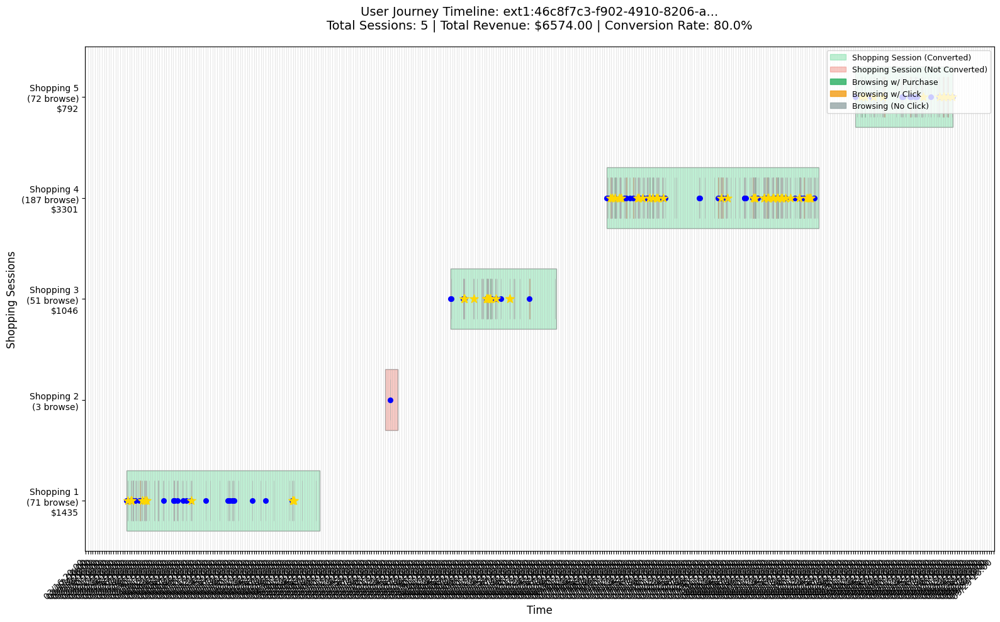


📊 USER JOURNEY SUMMARY STATISTICS
--------------------------------------------------
User ID: ext1:46c8f7c3-f902-4910-8206-a51eeff9de3d
Total Shopping Sessions: 5
Total Browsing Sessions: 384
Average Browsing Sessions per Shopping: 76.8
Total Events: 9936
Total Clicks: 517
Total Purchases: 127
Total Revenue: $6574.00
Conversion Rate: 80.0%
Average Order Value (when purchased): $1643.50

User Rank #2
Total Revenue: $5541.00
Number of Shopping Sessions: 3
Conversion Rate: 100.0%


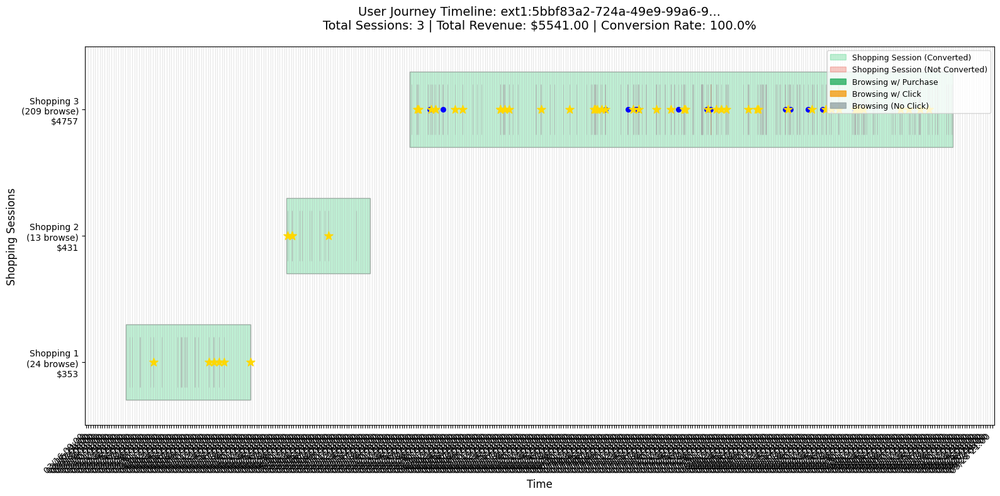


📊 USER JOURNEY SUMMARY STATISTICS
--------------------------------------------------
User ID: ext1:5bbf83a2-724a-49e9-99a6-99b663e23ff1
Total Shopping Sessions: 3
Total Browsing Sessions: 246
Average Browsing Sessions per Shopping: 82.0
Total Events: 3107
Total Clicks: 30
Total Purchases: 137
Total Revenue: $5541.00
Conversion Rate: 100.0%
Average Order Value (when purchased): $1847.00


In [14]:
# %%
# --- GANTT CHART VISUALIZATION FOR USER JOURNEY ---

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.patches import Rectangle
import matplotlib.dates as mdates
from datetime import datetime

def create_user_journey_gantt(user_id: str, 
                              df_shopping_sessions: pd.DataFrame,
                              df_browsing_sessions: pd.DataFrame,
                              journey_data: dict):
    """
    Creates a Gantt chart showing a user's complete journey with:
    - Shopping sessions as thick bars
    - Browsing sessions as thinner bars within
    - Event markers for key activities
    """
    
    # Get user's shopping sessions
    user_shopping = df_shopping_sessions[df_shopping_sessions['user_id'] == user_id].sort_values('shopping_start')
    if user_shopping.empty:
        print(f"No shopping sessions found for user {user_id}")
        return
    
    # Get user's browsing sessions
    user_browsing = df_browsing_sessions[
        df_browsing_sessions['shopping_session_id'].isin(user_shopping['shopping_session_id'])
    ].sort_values('session_start')
    
    # Create figure
    fig, ax = plt.subplots(figsize=(16, max(8, len(user_shopping) * 2)))
    
    # Color scheme
    colors = {
        'shopping_converted': '#2ecc71',  # Green for converting shopping sessions
        'shopping_not_converted': '#e74c3c',  # Red for non-converting
        'browsing_with_purchase': '#27ae60',  # Dark green for browsing with purchase
        'browsing_with_click': '#f39c12',  # Orange for browsing with clicks
        'browsing_no_click': '#95a5a6',  # Gray for browsing without clicks
    }
    
    # Plot shopping sessions
    y_pos = 0
    y_labels = []
    y_positions = []
    
    for _, shop_session in user_shopping.iterrows():
        # Shopping session bar
        start = shop_session['shopping_start']
        duration = (shop_session['shopping_end'] - start).total_seconds() / 3600  # in hours
        
        color = colors['shopping_converted'] if shop_session['did_purchase'] else colors['shopping_not_converted']
        
        # Main shopping session bar (thick)
        rect = Rectangle((mdates.date2num(start), y_pos - 0.3), 
                        duration/24,  # Convert hours to matplotlib date units
                        0.6, 
                        facecolor=color, 
                        alpha=0.3,
                        edgecolor='black',
                        linewidth=1)
        ax.add_patch(rect)
        
        # Add browsing sessions within
        browsing_in_session = user_browsing[
            user_browsing['shopping_session_id'] == shop_session['shopping_session_id']
        ]
        
        for _, browse_session in browsing_in_session.iterrows():
            browse_start = browse_session['session_start']
            browse_duration = browse_session['duration_minutes'] / 60 / 24  # Convert to days for matplotlib
            
            # Determine color based on activity
            if browse_session['num_purchases'] > 0:
                browse_color = colors['browsing_with_purchase']
            elif browse_session['num_clicks'] > 0:
                browse_color = colors['browsing_with_click']
            else:
                browse_color = colors['browsing_no_click']
            
            # Browsing session bar (thinner, within shopping session)
            browse_rect = Rectangle((mdates.date2num(browse_start), y_pos - 0.2),
                                   browse_duration,
                                   0.4,
                                   facecolor=browse_color,
                                   alpha=0.8,
                                   edgecolor='darkgray',
                                   linewidth=0.5)
            ax.add_patch(browse_rect)
            
            # Add event markers
            if browse_session['num_clicks'] > 0:
                ax.scatter(mdates.date2num(browse_start), y_pos, 
                          marker='o', s=30, color='blue', zorder=3, label='Click' if y_pos == 0 else "")
            
            if browse_session['num_purchases'] > 0:
                ax.scatter(mdates.date2num(browse_start), y_pos, 
                          marker='*', s=100, color='gold', zorder=4, label='Purchase' if y_pos == 0 else "")
        
        # Label
        session_label = f"Shopping {y_pos+1}\n({int(shop_session['num_browsing_sessions'])} browse)"
        if shop_session['total_revenue_usd'] > 0:
            session_label += f"\n${shop_session['total_revenue_usd']:.0f}"
        
        y_labels.append(session_label)
        y_positions.append(y_pos)
        y_pos += 1
    
    # Format axes
    ax.set_yticks(y_positions)
    ax.set_yticklabels(y_labels)
    ax.set_ylim(-0.5, len(user_shopping) - 0.5)
    
    # Format x-axis as dates
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d %H:%M'))
    ax.xaxis.set_major_locator(mdates.HourLocator(interval=12))
    plt.xticks(rotation=45, ha='right')
    
    # Add grid
    ax.grid(True, axis='x', alpha=0.3)
    
    # Add legend
    legend_elements = [
        mpatches.Patch(color=colors['shopping_converted'], alpha=0.3, label='Shopping Session (Converted)'),
        mpatches.Patch(color=colors['shopping_not_converted'], alpha=0.3, label='Shopping Session (Not Converted)'),
        mpatches.Patch(color=colors['browsing_with_purchase'], alpha=0.8, label='Browsing w/ Purchase'),
        mpatches.Patch(color=colors['browsing_with_click'], alpha=0.8, label='Browsing w/ Click'),
        mpatches.Patch(color=colors['browsing_no_click'], alpha=0.8, label='Browsing (No Click)'),
    ]
    ax.legend(handles=legend_elements, loc='upper right', fontsize=9)
    
    # Titles and labels
    ax.set_xlabel('Time', fontsize=12)
    ax.set_ylabel('Shopping Sessions', fontsize=12)
    ax.set_title(f'User Journey Timeline: {user_id[:30]}...\n'
                f'Total Sessions: {len(user_shopping)} | '
                f'Total Revenue: ${user_shopping["total_revenue_usd"].sum():.2f} | '
                f'Conversion Rate: {(user_shopping["did_purchase"].sum()/len(user_shopping)*100):.1f}%',
                fontsize=14, pad=20)
    
    plt.tight_layout()
    plt.show()
    
    # Print summary statistics
    print("\n📊 USER JOURNEY SUMMARY STATISTICS")
    print("-" * 50)
    print(f"User ID: {user_id}")
    print(f"Total Shopping Sessions: {len(user_shopping)}")
    print(f"Total Browsing Sessions: {len(user_browsing)}")
    print(f"Average Browsing Sessions per Shopping: {len(user_browsing)/len(user_shopping):.1f}")
    print(f"Total Events: {user_shopping['total_events'].sum()}")
    print(f"Total Clicks: {user_shopping['total_clicks'].sum()}")
    print(f"Total Purchases: {user_shopping['total_purchases'].sum()}")
    print(f"Total Revenue: ${user_shopping['total_revenue_usd'].sum():.2f}")
    print(f"Conversion Rate: {user_shopping['did_purchase'].mean():.1%}")
    print(f"Average Order Value (when purchased): ${user_shopping[user_shopping['did_purchase']==1]['total_revenue_usd'].mean():.2f}")
    

def visualize_top_users(df_shopping_sessions: pd.DataFrame,
                        df_browsing_sessions: pd.DataFrame,
                        journey_data: dict,
                        n_users: int = 2):
    """
    Creates Gantt charts for the top N users by total revenue
    """
    
    # Find top users by revenue
    user_revenue = df_shopping_sessions.groupby('user_id').agg({
        'total_revenue_usd': 'sum',
        'shopping_session_id': 'count',
        'did_purchase': 'mean'
    }).rename(columns={
        'shopping_session_id': 'num_sessions',
        'did_purchase': 'conversion_rate'
    })
    
    # Get top revenue users
    top_users = user_revenue.nlargest(n_users, 'total_revenue_usd')
    
    print("\n" + "#"*100)
    print(f"### GANTT CHART VISUALIZATION: TOP {n_users} USERS BY REVENUE ###")
    print("#"*100)
    
    for user_id, stats in top_users.iterrows():
        print(f"\n{'='*80}")
        print(f"User Rank #{list(top_users.index).index(user_id) + 1}")
        print(f"Total Revenue: ${stats['total_revenue_usd']:.2f}")
        print(f"Number of Shopping Sessions: {int(stats['num_sessions'])}")
        print(f"Conversion Rate: {stats['conversion_rate']:.1%}")
        print(f"{'='*80}")
        
        create_user_journey_gantt(user_id, df_shopping_sessions, 
                                 df_browsing_sessions, journey_data)

# Execute visualization
if 'df_shopping_sessions' in locals() and 'df_browsing_sessions' in locals():
    visualize_top_users(df_shopping_sessions, df_browsing_sessions, journey_data, n_users=2)